# Covid-19 Spike Protein Example 1: Residue Neighborhoods

In this notebook, we use mdciao to analyse publicly available MD data of the Covid-19 Spike Protein, curated in the impressive [**COVID-19 Molecular Structure and Therapeutics Hub**](https://covid.molssi.org) put together by the [Molecular Sciences Software Institute (molSSI)](https://covid.molssi.org/). 

In particular, we use the data generated in the [Chodera-Lab](https://www.choderalab.org/) by Ivy Zhang, consisting of
[Folding@home simulations of the SARS-CoV-2 spike RBD bound to human ACE2 (725.3 µs )](https://covid.molssi.org//simulations/#foldinghome-simulations-of-the-sars-cov-2-spike-rbd-bound-to-human-ace2). We quote:

> All-atom MD simulations of the SARS-CoV-2 spike protein receptor binding domain (RBD) bound to human angiotensin converting enzyme-related carboypeptidase (ACE2), simulated using Folding@Home. The “wild-type” RBD and three mutants (N439K, K417V, and the double mutant N439K/K417V) were simulated.  
...  
RUNs denote different RBD mutants: N439K (RUN0), K417V (RUN1), N439K/K417V (RUN2), and WT (RUN3). CLONEs denote different independent replica trajectories

## Goals

We are going to use ``mdciao`` to compare the effect of the above mutations on the mutated residues's vicinities or *neighborhoods*. This is rather simple:

1. Compute the residue neighborhoods for the mutated positions ``N439`` and ``K417`` in all four datasets, using [mdciao.cli.residue_neighborhoods](https://proteinformatics.uni-leipzig.de/mdciao/api/generated/generated/mdciao.cli.residue_neighborhoods.html)

2. Compare these neighborhoods using [mdciao.cli.compare](https://proteinformatics.uni-leipzig.de/mdciao/api/generated/generated/mdciao.cli.compare.html) for changes in the residue-residue contacts.

## Residues of Interest and Molecular Topology
Since we're not really familiar with the dataset, we can do several things to ease us into the data. Most helpful is to visualize one sample file in 3D, using the awesome [nglviewer](https://github.com/nglviewer/) and [mdtraj](https://mdtraj.org/). We can visually inspect the setup, its components etc:

<div class="alert alert-info">
    
<b>Note</b> 
    
A great deal of ``mdciao``'s handling of molecular information and I/O is done using ``mdtraj``.

</div>

In [1]:
import nglview, mdtraj as md
iwd = nglview.show_mdtraj(md.load("run3-clone0.stride.050.h5")[0])
iwd

_ColormakerRegistry()

NGLWidget()

Next, we'll use ``mdciao``'s [mdciao.cli.residue_selection](https://proteinformatics.uni-leipzig.de/mdciao/api/generated/generated/mdciao.cli.residue_selection.html) to **locate the mutated residues in the molecular topology**. Since [mdciao.cli.residue_selection](https://proteinformatics.uni-leipzig.de/mdciao/api/generated/generated/mdciao.cli.residue_selection.html) internally calls [mdciao.fragments.get_fragments](https://proteinformatics.uni-leipzig.de/mdciao/api/generated/generated/mdciao.fragments.get_fragments.html), we also get to see how the topology is structured into chains 

<div class="alert alert-info">
    
<b>Note</b> 
    
``chains`` isn't really a heuristic, since the ``.h5`` files contain chain-tags for the residues, but that will very often not be the case.

</div>



In [2]:
import mdtraj as md
import nglview
import mdciao
import numpy as np
from glob import glob

In [3]:
#datadir = "/media/perezheg/6TB_HD/FAH_aws/strided/50"
datadir="."
import os
for ff in sorted(glob(os.path.join(datadir, "run?-clone0*h5"))):
    print("Chains for files of type:",os.path.basename(ff))
    mdciao.cli.residue_selection([417,439],ff,fragments=["chains"]);
    #frags = mdciao.fragments.get_fragments(ff, method="chains");
    print()

Chains for files of type: run0-clone0.stride.050.h5
Using method 'chains' these fragments were found
fragment      0 with  196 AAs   ACE332           (   0) -   NME527           (195 ) (0) 
fragment      1 with   10 AAs   UYB729           ( 196) -   0fA738           (205 ) (1) 
fragment      2 with  709 AAs    ACE18           ( 206) -   NME726           (914 ) (2) 
fragment      3 with   58 AAs   UYB739           ( 915) -   0fA796           (972 ) (3) 
fragment      4 with    2 AAs    CL973           ( 973) -      ZN1           (974 ) (4)  resSeq jumps
fragment      5 with  365 AAs   Na+976           ( 975) -  Na+1340           (1339) (5) 
0.0)       LYS417 in fragment 0 with residue index 85
2.0)       HIS417 in fragment 2 with residue index 605

0.0)       LYS439 in fragment 0 with residue index 107
2.0)       LEU439 in fragment 2 with residue index 627

Your selection '[417, 439]' yields:
   residue      residx    fragment      resSeq         BW        CGN
    LYS417          85    

Some observations:

1. All setups have the same overall topology, with the same **six fragments/chains**:
   * RBD (SARS-CoV-2 spike protein receptor binding domain)
   * Glycosylations@RBD
   * ACE (human angiotensin converting enzyme-related carboypeptidase)
   * Glysicalations@RBD
   * ions (probably crystallographic ions CL and ZN)
   * ions (NaCl)
 
2. We clearly identify that the residues with [resSeq](https://mdtraj.org/1.6.2/atom_selection.html#keywords) ``417`` and ``439`` in the Spike-RBD have the serial indices ``85`` and ``107``, respectively in **all setups**. It's the part of the outputs that look like this:

```
0.0)       LYS417 in fragment 0 with residue index 85
2.0)       HIS417 in fragment 2 with residue index 605

0.0)       ASN439 in fragment 0 with residue index 107
2.0)       LEU439 in fragment 2 with residue index 627

Your selection '[417, 439]' yields:
   residue      residx    fragment      resSeq         BW        CGN
    LYS417          85           0        417       None       None
    HIS417         605           2        417       None       None
    ASN439         107           0        439       None       None
    LEU439         627           2        439       None       None
```

3. Depending on the ``RUN`` index (0 to 3), these positions have different aminoacids (AAs) because of point mutations:
   * *run0* : N439K

   * *run1* : K417V

   * *run2* : N439K/K417V

   * *run3* : WT

  We can also use the ``RUN1,RUN2,...`` filename-schemes to create a dictionary assigning filenaming-schemes to a setup, as we do below with the ``filename2system``-dictionary:

In [4]:
filename2system = {
    "run0" : "N439K",
    "run1" : "K417V",
    "run2" : "N439K/K417V",
    "run3" : "WT"
}

## Viewing Local Changes through Residue Neighborhoods
We now compute the residue neighborhoods around the mutated sites using [mdciao.cli.residue_neighborhoods](https://proteinformatics.uni-leipzig.de/mdciao/api/generated/generated/mdciao.cli.residue_neighborhoods.html). 

Since the point-mutations didn't alter the serial indices 85 and 107 for resSeqs 417 and 439, respectively, we can use them to address these positions in all setups.

### Computing the Neighborhoods

Will compute contact frequencies for (2 items):
./run0-clone0.stride.050.h5
./run0-clone1.stride.050.h5
 with a stride of 1 frames
Using method 'chains' these fragments were found
fragment      0 with  196 AAs   ACE332           (   0) -   NME527           (195 ) (0) 
fragment      1 with   10 AAs   UYB729           ( 196) -   0fA738           (205 ) (1) 
fragment      2 with  709 AAs    ACE18           ( 206) -   NME726           (914 ) (2) 
fragment      3 with   58 AAs   UYB739           ( 915) -   0fA796           (972 ) (3) 
fragment      4 with    2 AAs    CL973           ( 973) -      ZN1           (974 ) (4)  resSeq jumps
fragment      5 with  365 AAs   Na+976           ( 975) -  Na+1340           (1339) (5) 

Will compute neighborhoods for the residues
[85, 107]
excluding 4 nearest neighbors

   residue      residx    fragment      resSeq         BW        CGN
    LYS417          85           0        417       None       None
    LYS439         107           0        439     


Pre-computing likely neighborhoods by reducing the neighbor-list
to those within 15 Angstrom in the first frame of reference geom
'<mdtraj.Trajectory with 1 frames, 16340 atoms, 1341 residues, and unitcells>':...done!
From 2664 potential distances, the neighborhoods have been reduced to only 179 potential contacts.
If this number is still too high (i.e. the computation is too slow), consider using a smaller nlist_cutoff_Ang 

#idx   freq      contact       fragments     res_idxs      ctc_idx  Sum
1:     1.00   LYS417-ASN422       0-0          85-90         21     1.00
2:     0.93   LYS417-LEU455       0-0          85-123        30     1.93
3:     0.53   LYS417-ARG454       0-0          85-122        29     2.47
4:     0.53   LYS417-GLN409       0-0          85-77         17     3.00
5:     0.47   LYS417-ASP30        0-2          85-218        83     3.47
6:     0.33   LYS417-HIS34        0-2          85-222        87     3.80
7:     0.20   LYS417-PHE456       0-0          85-124      

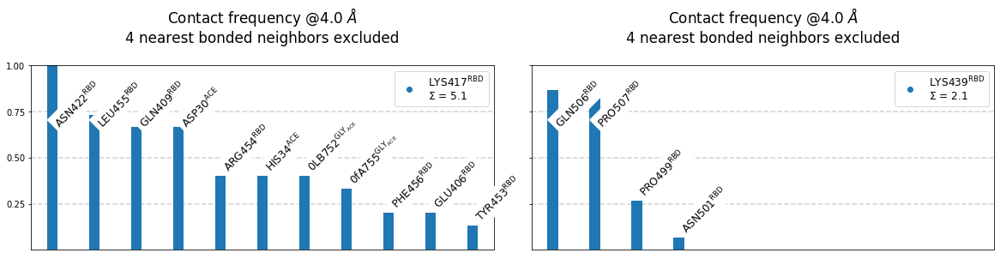

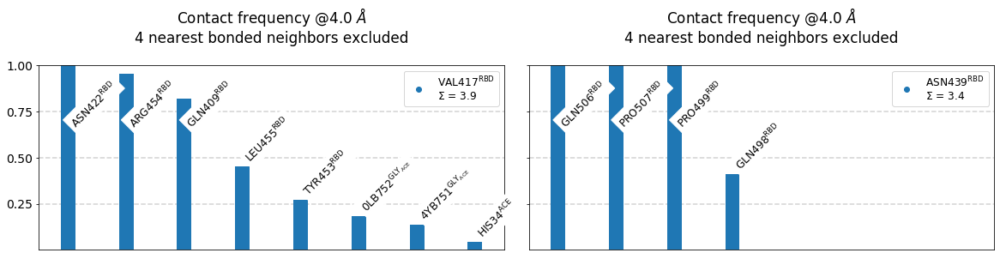

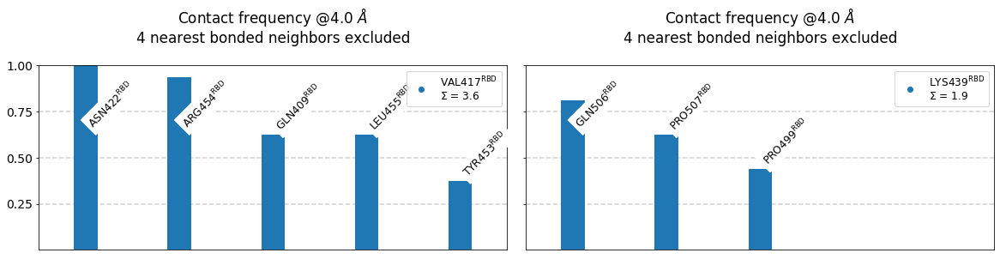

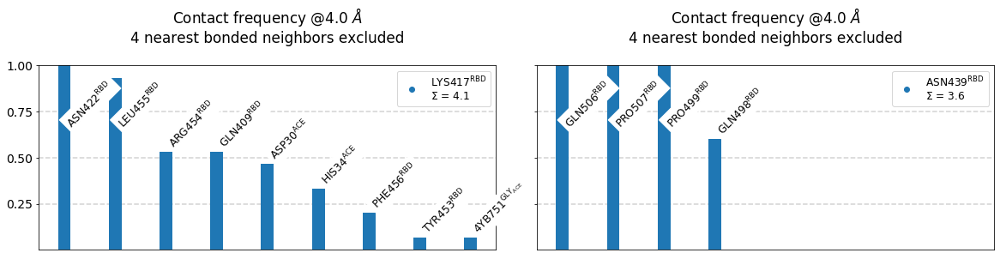

In [5]:
neighborhoods = {}
for fn, syskey in filename2system.items():
    pattern = os.path.join(datadir,fn+"*.h5")
    files = glob(pattern)[:]
    ineigh = mdciao.cli.residue_neighborhoods([85,107], 
                                              files[:20],#pattern,
                                              res_idxs=True, 
                                              n_jobs=7,
                                              ctc_cutoff_Ang=4,
                                              fragment_names=["RBD","GLY_RBD","ACE","GLY_ACE","ions","ions"],
                                              fragments=["chains"], 
                                              ctc_control=.99,
                                              no_disk=True,                                              
                                              plot_timedep=False)["neighborhoods"]
    neighborhoods[syskey]=ineigh

After we have computed the per-residue neighborhoods, the next cell is just some reordering of the data into more practical, per-residue dictionaries:

In [6]:
neighborhoods = {key : neighborhoods[key] for key in ['WT', 'K417V', 'N439K','N439K/K417V']}
pos417 = {key:val[85] for key, val in neighborhoods.items()}
pos439 = {key:val[107] for key, val in neighborhoods.items()}

Before we continue, we can save the neighborhoods for later use, s.t. they don't have to be computed every time:

In [7]:
#np.save("pos417.npy",pos417)
#np.save("pos439.npy",pos439)

### Plotting the Contact-Frequencies

Next, we use [mdciao.cli.compare](https://proteinformatics.uni-leipzig.de/mdciao/api/generated/generated/mdciao.cli.compare.html) plot the per-residue contact-frequencies of all four systems next to one another. The function call can be minimal or very customized, here we present some parameter values that yield the most informative plots:

These interactions are not shared:
0LB752@GLY_ACE, 0fA755@GLY_ACE, 4YB751@GLY_ACE, A2753@GLY_ACE, D30@ACE, E406@RBD, F456@RBD
Their cumulative ctc freq is 2.94. 
Created files
freq_comparison.pdf
freq_comparison.xlsx
These interactions are not shared:
Q325@ACE, Q498@RBD
Their cumulative ctc freq is 1.16. 
Created files
freq_comparison.pdf
freq_comparison.xlsx


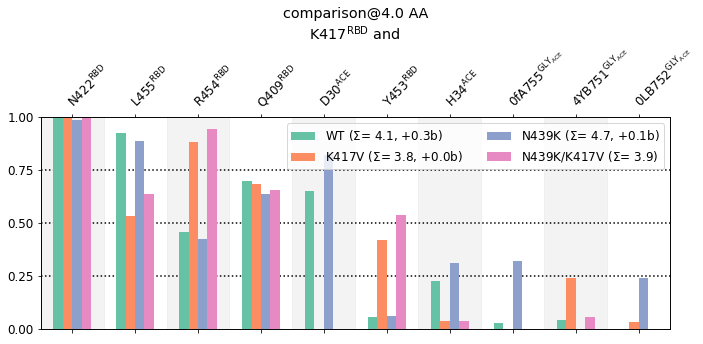

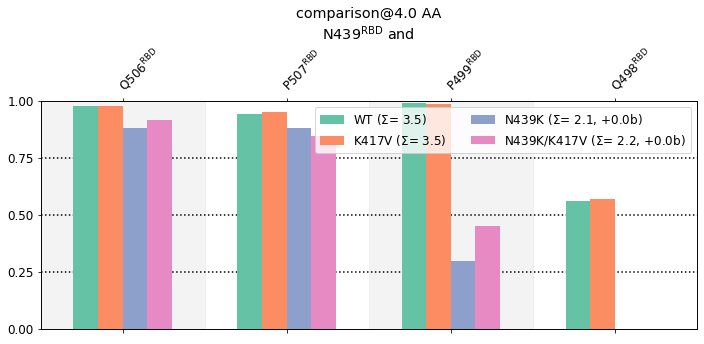

In [8]:
pos417 = np.load("pos417.npy",allow_pickle=True)[()]
pos439 = np.load("pos439.npy",allow_pickle=True)[()]
mdciao.cli.compare(pos417, ctc_cutoff_Ang=4,
                   mutations_dict={"V417": "K417",  
                                   "K439": "N439"
                                  },
                   anchor="K417",
                   defrag=None,
                   width=.15,
                   lower_cutoff_val=.2,
                   fontsize=12,
                   legend_rows=2,
                   colors="Set2",
                   #distro=True,
                   #n_cols=3,
                  );

mdciao.cli.compare(pos439, ctc_cutoff_Ang=4,
                   mutations_dict={"V417": "K417", 
                                   "K439": "N439"
                                  },
                   anchor="N439",
                   width=.15,
                   lower_cutoff_val=.2,
                   defrag=None,
                   fontsize=12,
                   legend_rows=2,
                   colors="Set2"
                  );

Some observations:

* In the K417@RBD-neighborhood
  * The K417V mutants (single or double)
    * disrupt the K417@RBD-D30@ACE salt-bridge entirely (expected)
    * disrupt the K417@RBD-L455@RBD interaction, possibly to 
    * enhance the K417@RBD-R454@RBD and K417@RBD-Y453@RBD interactions
  * The N439K mutant doesn't affect the K417@RBD neighborhood much (the green and blue bars are similar)
 
* In the N439@RBD-neighborhood:
  * The N439K mutants (single or double):
    * disrupt the N439@RBD-P499@RBD and N439@RBD-Q498@RBD interactions
  * Don't seem to alter much of the rest of the neighborhood
 


### Distributions and Violin Plots
Frequencies with a hard cutoff (4 Angstrom, in this case) are reductive, and don't tell the whole story, but allow for a **compact** overview a the large dataset (8K trajectories, 4 setups) in **one plot per mutated residue**, and already give an impression of the local changes around the mutated sites.

To get a cut-off independent comparison, we can use several ``mdciao``-methods:

1. Use again ``mdciao.cli.compare``, but uncommenting the ``distro=True`` parameter:   
  For each residue neighborhood, this will produce a multi-panel figure (you can control its column-to-row form with ``n_cols``) where each panel contains the distribution of one residue-residue distance for all systems: ``'WT', 'K417V', 'N439K','N439K/K417V'``. The distributions are much more telling of the behaviour of the residue-residue distance, informing about it's about it's modes and spread.
  
<div class="alert alert-info">
    
<b>Note</b> 
    
You also have to comment-out the ``lower_cutoff_val=.2`` parameter.

</div>

2. Compact all the distributions into one single-panel, using [violin-plots](https://en.wikipedia.org/wiki/Violin_plot).  
  The violins are simply the same distributions as above, only mirored (to get the nice, symmetric violins) and oriented vertically along the y-axis
  
Let's try both options for the K417-neighborhood: 

Created files
freq_comparison.pdf
freq_comparison.xlsx


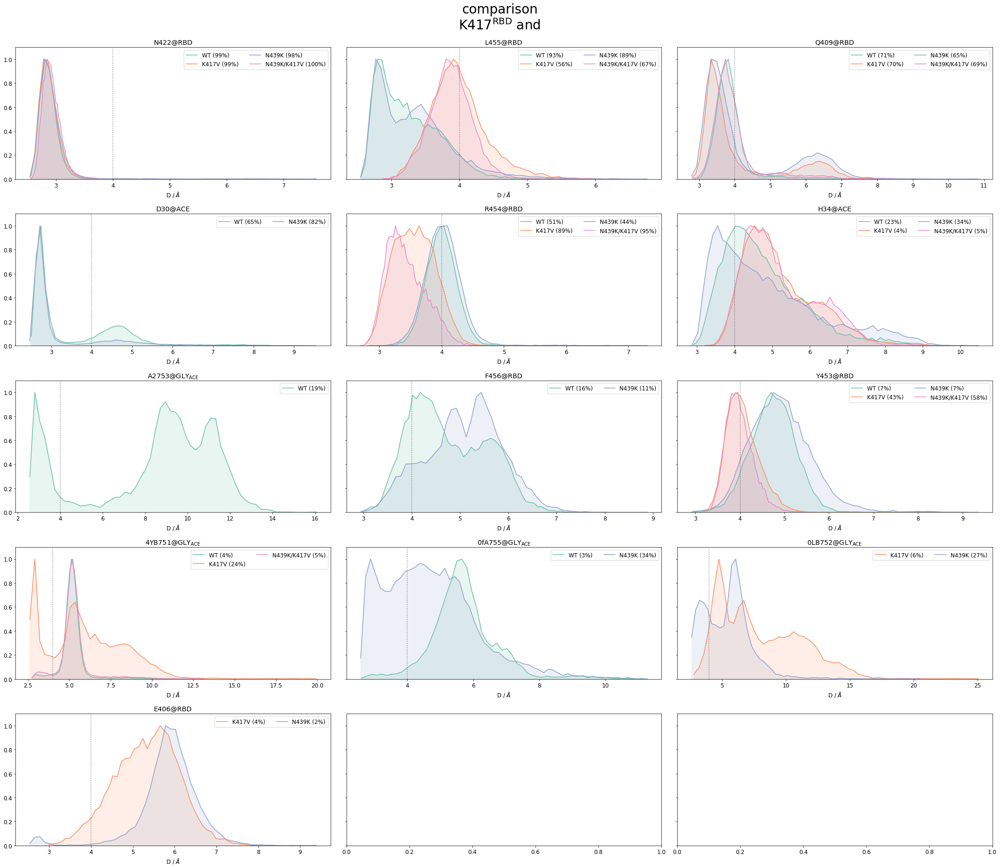

In [9]:
pos417 = np.load("pos417.npy",allow_pickle=True)[()]
mdciao.cli.compare(pos417, ctc_cutoff_Ang=4,
                   mutations_dict={"V417": "K417",  
                                   "K439": "N439"
                                  },
                   anchor="K417",
                   defrag=None,
                   width=.15,
                   #lower_cutoff_val=.2,
                   fontsize=12,
                   legend_rows=2,
                   colors="Set2",
                   distro=True,
                   n_cols=3,
                   #sharex=True,
                  );

The multi-panel figure gives more detail about each residue-residue distance, but makes comparing accross distances a bit harder (even if you use the ``sharex=True`` parameter, which you should try). 

Now we try the comparison via violin plots, using [mdciao.plots.compare_violins](https://proteinformatics.uni-leipzig.de/mdciao/api/generated/generated/mdciao.plots.compare_violins.html):

(<Figure size 1080x360 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f83cbf2bf10>)

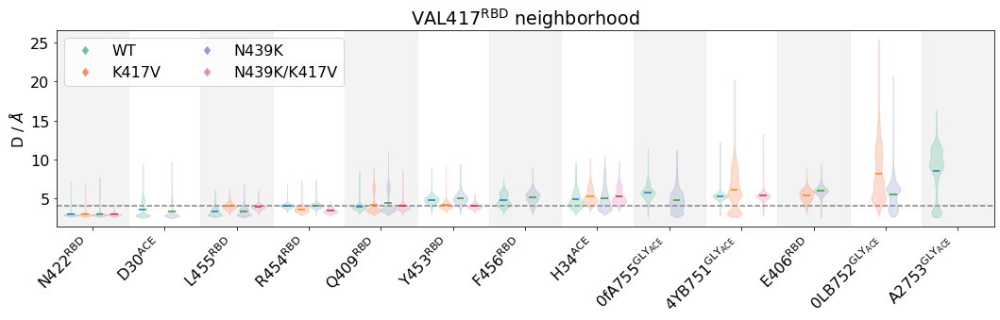

In [10]:
mdciao.plots.compare_violins(pos417, 
                             ctc_cutoff_Ang=4,
                             figsize=(15,5),
                             colors="Set2",
                             defrag=None,
                             anchor="K417",
                             legend_rows=2,
                             mutations_dict={"V417": "K417",
                                             "K439": "N439"
                                            }
                            )

This plot is now more crowded but contains more information in one single panel, allowing to quickly differentiate the residue-residue distance-distributions, and the effect that the mutations have on them. We see how some of them remain compact, some are simply shifted, some are bimodal, have long tails etc. 
 
<div class="alert alert-info">
    
<b>Note</b> 
    
It's a good exercise to compare the violins with the individual, per-contact panels from above and see that, indeed, the violins are just mirrored distributions.
    
</div>

## Targeting Pre-Defined Sites
Wheareas the [mdciao.cli.residue_neighborhoods](https://proteinformatics.uni-leipzig.de/mdciao/api/generated/generated/mdciao.cli.residue_neighborhoods.html) creates a list of likely neighbors by using an **initial, generous cutoff** (15 Angstrom, in this case), we can also simply **provide a list** of residue-residue distances of interest, regardless of whether they're likely neighbors or not. This has the advantage of reducing the number of overall residue-residue distances computed, but neglects anything **not** included in that list. 

In ``mdciao``, such a small(ish) group of contacts is called a ``site``, and there's an [API-submodule](https://proteinformatics.uni-leipzig.de/mdciao/api/generated/mdciao.sites.html) to handle them as well as a CLI-method to compute them, [mdciao.cli.sites](https://proteinformatics.uni-leipzig.de/mdciao/api/generated/generated/mdciao.cli.sites.html).

To select these contacts of interest, we can use our observations of the frequency plots from above. We will focus on the contacts **most impacted by the mutations**, and put them into a ``site`` definition, which is just a python dictionary with some human-readable form.

<div class="alert alert-info">
    
<b>Note</b> 
   
Although the word *``site``* somehow hints at the contacts being spatially close (like a binding site, or a motif, etc), this doesn't have to be the case. *``site``* is just a label under which to group contacts.
    
In any case, you can pass a list of ``sites`` to the CLI and API methods if you prefer to break down a large(ish) list of contacts into several smaller ones.
    
Check [mdciao.sites](https://proteinformatics.uni-leipzig.de/mdciao/api/generated/mdciao.sites.html) for more info on constructing sites, interactively or as [.JSON](https://www.json.org/json-en.html) files.
    
</div>

In [11]:
my_site ={"name" :"changed contacts",
          "pairs":{"AAresSeq":[
                     "K417-D30",
                     "K417-L455",
                     "K417-R454",
                     "K417-Y453",
                     "N439-P499",
                     "N439-Q498"
                     ]}}

We do a little Python to make sure the above dictionary works with all mutants:

In [12]:
from copy import deepcopy
my_sites_mut_adapted={}
for syskey in filename2system.values():
    #print(syskey)
    my_sites_mut_adapted[syskey]=deepcopy(my_site)
    mutations_dict={}
    
    #Only populate mutations_dict if needed
    if syskey!="WT":
        for mut in syskey.split("/"):
            mutations_dict.update({mut[:4]:mut[-1]+mut[1:-1]})
    # We use one of mdciao's str_and_dict method for recursive mutation
    my_sites_mut_adapted[syskey]["pairs"]['AAresSeq']=[mdciao.utils.str_and_dict.replace_w_dict(pair,mutations_dict) for pair in my_sites_mut_adapted[syskey]["pairs"]["AAresSeq"]]
my_sites_mut_adapted

{'N439K': {'name': 'changed contacts',
  'pairs': {'AAresSeq': ['K417-D30',
    'K417-L455',
    'K417-R454',
    'K417-Y453',
    'K439-P499',
    'K439-Q498']}},
 'K417V': {'name': 'changed contacts',
  'pairs': {'AAresSeq': ['V417-D30',
    'V417-L455',
    'V417-R454',
    'V417-Y453',
    'N439-P499',
    'N439-Q498']}},
 'N439K/K417V': {'name': 'changed contacts',
  'pairs': {'AAresSeq': ['V417-D30',
    'V417-L455',
    'V417-R454',
    'V417-Y453',
    'K439-P499',
    'K439-Q498']}},
 'WT': {'name': 'changed contacts',
  'pairs': {'AAresSeq': ['K417-D30',
    'K417-L455',
    'K417-R454',
    'K417-Y453',
    'N439-P499',
    'N439-Q498']}}}

Now that we have per-setup site definitions, we *simply* iterate again over setups passing the corresponding site definition:

<div class="alert alert-info">
    
<b>Note</b> 
    
*simply* means that a very simple call to the method would be enough. Below, we use the optional parameters to showcase some of the advanced functionality.
    
</div>

### Computing the Sites

In [13]:
sites = {}
for fn, syskey in filename2system.items():
    print(syskey)
    pattern = os.path.join(datadir,fn+"*.h5")
    files = glob(pattern)[:]
    sites[syskey] = mdciao.cli.sites([my_sites_mut_adapted[syskey]], 
                                     #files[:],
                                     pattern,
                                     n_jobs=7,
                                     ctc_cutoff_Ang=4,
                                     fragment_names=["RBD","GLY_RBD","ACE","GLY_ACE","ions","ions"],
                                     fragments=["chains"], 
                                     no_disk=True,
                                     figures=False,
                                     plot_timedep=False)["changed contacts"]

N439K
Will compute the sites
 site dict with name changed contacts
in the trajectories:
./run0-clone0.stride.050.h5
./run0-clone1.stride.050.h5
 with a stride of 1 frames.

Using method 'chains' these fragments were found
fragment      0 with  196 AAs   ACE332           (   0) -   NME527           (195 ) (0) 
fragment      1 with   10 AAs   UYB729           ( 196) -   0fA738           (205 ) (1) 
fragment      2 with  709 AAs    ACE18           ( 206) -   NME726           (914 ) (2) 
fragment      3 with   58 AAs   UYB739           ( 915) -   0fA796           (972 ) (3) 
fragment      4 with    2 AAs    CL973           ( 973) -      ZN1           (974 ) (4)  resSeq jumps
fragment      5 with  365 AAs   Na+976           ( 975) -  Na+1340           (1339) (5) 
   residue      residx    fragment      resSeq         BW        CGN
    LYS417          85           0         85       None       None
    LYS439         107           0        107       None       None
    TYR453         121    

We can also save the sites for later use:

In [14]:
#np.save("sites.npy",sites)

### Reporting the Sites

Finally, we can use again the ``compare``-method of ``mdciao`` to see the impact of the mutations on the site. Since the overall number of computed distances is much smaller, we can use the ``distro==True`` and get much more information on the distances without having a large figure:

Created files
freq_comparison.pdf
freq_comparison.xlsx


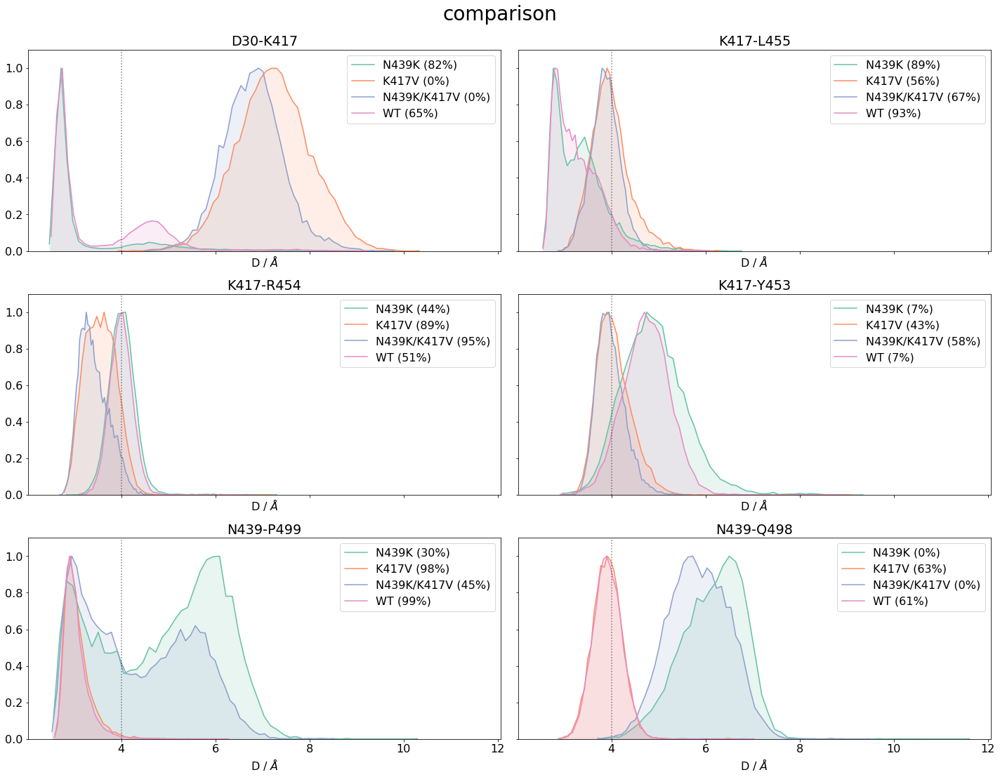

In [15]:
sites = np.load("sites.npy",allow_pickle=True)[()]
mdciao.cli.compare(sites, distro=True, 
                   n_cols=2, 
                   mutations_dict={"V417": "K417",  
                                   "K439": "N439"
                                  },
                   sharex=True,
                   ctc_cutoff_Ang=4,
                   colors="Set2");

We see the effects mentioned before about the disruption of salt-bridges by e.g. with ``D30``, in the upper left panel. We also notice that the frequencies reported in the legend coincide with those initially reported in the bar plots at the very top of this page.

<div class="alert alert-info">
    
<b>Note</b> 
    
When comparing these distributions obtained via the ``site``-method, with the distributions reported further up, both as *per-contact* panels or in the *one-panel-for-all* violin-plots, you'll notice that some distributions are missing. Look, for example, at the the ``K417-D30`` violins: two of them are missing.
    
This is **per-design**: when computing those residue neighborhoods using [mdciao.cli.residue_neighborhoods](https://proteinformatics.uni-leipzig.de/mdciao/api/generated/generated/mdciao.cli.residue_neighborhoods.html), we specified ``ctc_cutoff_Ang = 4``. This means that only those residues considered neighbors at a cutoff of 4 Angstrom are kept in the results. In the ``K417V`` mutants, the salt bridge with ``D30`` is **totally disrupted** and never contributes to the frequency (only very marginally), so it has been completely eliminated from the neighborhood.

``site``-methods, on the other hand, have a static list of target residue-pairs and report on them regardless of whether they contribute to the neighborhood or not. The ``ctc_cutoff_Ang`` is used only to inform on frequencies, but not to control what contacts are kept in the ``site``.
    
Two last observations:
  
 * *sites* or *neighborhoods* are both [ContactGroup](https://proteinformatics.uni-leipzig.de/mdciao/api/generated/mdciao.contacts.html)-objects, and behave very similarly. A ``ContactGroup`` is ``mdciao``'s class to handle groups of residue-residue distances.
 * If you suspect that a residue-residue pair is missing from your figures and/or tables, please take a look at our [FAQ: Missing Contacts](https://proteinformatics.uni-leipzig.de/mdciao/FAQ.html#Missing-contacts).
    

</div>



## 3D Visualization
In future releases, we will include a method in the [ContactGroup](https://proteinformatics.uni-leipzig.de/mdciao/api/generated/mdciao.contacts.html) to automatically highlight it's residues in an [nglviewer](https://github.com/nglviewer/) widget. For now, we simply expose here how that method would look like:

In [17]:
def show_neighborhood3D(self,iwd,ctc_cutoff_Ang=None, top=None, representation="licorice"):
    if top is None:
        assert isinstance(self.top, md.Topology)
    if ctc_cutoff_Ang is None:
        freqs = np.ones(self.n_ctcs)
    else:
        freqs = self.frequency_per_contact(ctc_cutoff_Ang)
        
    if self.is_neighborhood:
        anchor_ats = [aa.index for aa in self.top.residue(self.shared_anchor_residue_index).atoms]
    atoms = []
    for fr, pair in zip(freqs, self.res_idxs_pairs):
        if fr >0:            
            for rr in pair:
                atoms.extend([aa.index for aa in self.top.residue(rr).atoms])
    [atoms.remove(aa) for aa in anchor_ats]
    iwd.add_representation(representation, selection=atoms)
    iwd.add_representation("ball_and_stick", selection=anchor_ats)
    iwd.add_representation("spacefill", selection=anchor_ats)

iwd = nglview.show_mdtraj(md.load("run3-clone0.stride.050.h5")[0])
show_neighborhood3D(pos417["WT"], 
                    iwd,
                    #representation="spacefill"
                   )

In [18]:
iwd

NGLWidget()